In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
!JAX_ENABLE_X64=True

In [3]:
import jax.numpy as jnp
import numpy as np
import jax
from tueplots import bundles
from tueplots.constants.color import rgb
import matplotlib.pyplot as plt
import pandas as pd

import pymc as pm
from pymc.gp import Latent
from pymc.gp.cov import RatQuad, ExpQuad, Periodic, WhiteNoise
from pymc.gp.mean import Constant

from jax import grad, hessian
from scipy import optimize

import numpyro
numpyro.set_host_device_count(16)
jax.config.update('jax_platform_name', 'cpu')
jax.config.update("jax_enable_x64", True)
plt.rcParams.update(bundles.beamer_moml())
plt.rcParams.update({'figure.dpi': 300})
plt.rcParams['font.family'] = 'DeJavu Serif'
plt.rcParams['font.serif'] = ['Times New Roman']

from utils import Gaussian
from utils import gp
from utils.bayes.media_transforms import shape, adstock

In [4]:
cp_terms = pd.read_csv('data/cpshake_gt.csv', skiprows=1, parse_dates=["Week"])
cp_terms = cp_terms.merge(pd.read_csv("data/protein_shak_gt.csv", skiprows=1, parse_dates=["Week"]), on="Week", how='left')
time = jnp.linspace(0, len(cp_terms)-1, len(cp_terms))[:, None]
cp_terms.columns = [col.replace(": (United States)", "") for col in cp_terms.columns]
cp_terms['Time'] = time

In [5]:
cp_terms.head()

,Week,Core Power Protein,protein shake core power,protein shake,Time
0,2019-12-29,17,10,47,0.0
1,2020-01-05,17,8,60,1.0
2,2020-01-12,21,8,58,2.0
3,2020-01-19,20,10,60,3.0
4,2020-01-26,19,6,58,4.0


In [6]:
time_plus = jnp.linspace(0, len(cp_terms)+30, len(cp_terms)+31)[:, None]

In [7]:
model_data = cp_terms.assign(CP_Protein_Impressions=lambda x: ((x['Core Power Protein']+.01)*10_000*np.exp(0.01*np.random.randn(len(x)))).astype(int), CP_Shake_Impressions=lambda x: ((x['protein shake core power']+.01)*4_000*np.exp(0.01*np.random.randn(len(x)))).astype(int))[["Week", "Time", "CP_Protein_Impressions", "CP_Shake_Impressions"]]
model_data.head()

,Week,Time,CP_Protein_Impressions,CP_Shake_Impressions
0,2019-12-29,0.0,169400,40813
1,2020-01-05,1.0,172196,31771
2,2020-01-12,2.0,209759,32265
3,2020-01-19,3.0,200685,40437
4,2020-01-26,4.0,191879,23945


In [8]:
jsp_logit = jax.scipy.special.logit
logit_ctr = jsp_logit(
  np.clip(
    (model_data["CP_Shake_Impressions"]/model_data["CP_Protein_Impressions"]).values, 
    0.1, 0.8)
  )

In [9]:
model_data.corr().style.background_gradient(cmap='coolwarm_r', vmin=-1, vmax=1)

,Week,Time,CP_Protein_Impressions,CP_Shake_Impressions
Week,1.000000,1.000000,0.918027,0.921596
Time,1.000000,1.000000,0.918027,0.921596
CP_Protein_Impressions,0.918027,0.918027,1.000000,0.975299
CP_Shake_Impressions,0.921596,0.921596,0.975299,1.000000


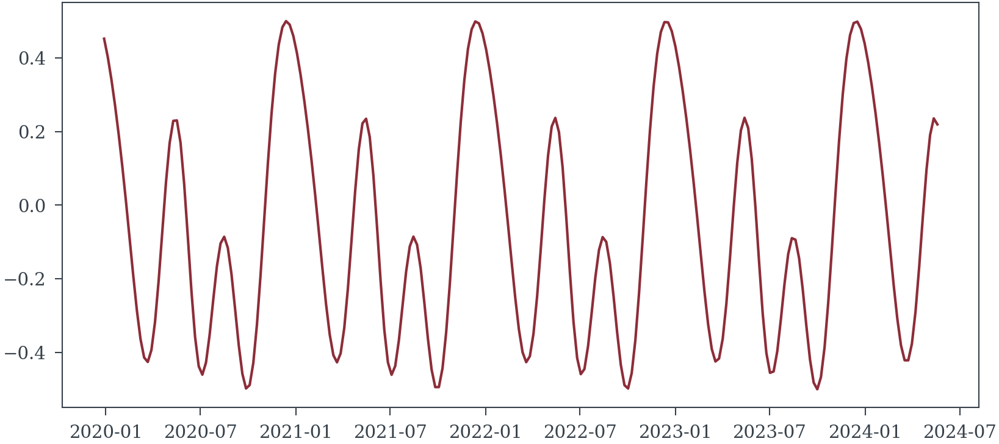

In [10]:
def generate_season(time, period=52.18, terms=4):
  betas_sin = np.random.randn(terms)
  betas_cos = np.random.randn(terms)
  
  sines = jnp.sum([jnp.sin(2*jnp.pi*(i+1)*time/period)/(2*(i+1)**1.4) for i in range(terms)]*betas_sin[None, :].T, axis=0)
  cosines = jnp.sum([jnp.cos(2*jnp.pi*(i+1)*time/period)/(2*(i+1)**1.4) for i in range(terms)]*betas_cos[None, :].T, axis=0)
  season_unadjusted = sines + cosines
  season = (season_unadjusted - jnp.min(season_unadjusted))
  season = season/jnp.max(season)
  return season - .5

plt.plot(model_data["Week"], generate_season(model_data["Time"].values, terms=5))

In [11]:
N_MEDIA = 8
m_ = np.random.normal(0, .2, size=(N_MEDIA,))[:, None]
s_ = np.random.normal(0, .5, size=(N_MEDIA,))[:, None]
season = generate_season(model_data["Time"].values)[None, :]
media_data = np.exp(
  np.random.normal(
    7
    + m_*(model_data["Time"]/model_data['Time'].max()).values[None, :] 
    + .1*season
    , 
    .4, 
    size=(N_MEDIA, len(model_data))
    )
  ).astype(int).T * np.random.binomial(1, .7, size=(len(model_data), N_MEDIA))

media_betas_imps = np.abs(np.random.randn(N_MEDIA)*.03+0.01)
media_saturation_imps = (np.random.beta(1, 3, size=(N_MEDIA,))*1 + 1.2)
media_shape_imps = (np.random.beta(1, 3, size=(N_MEDIA,))*3 + .9)

media_betas_clicks = np.abs(np.random.randn(N_MEDIA)*.01 + media_betas_imps)
media_saturation_clicks = np.abs(np.random.randn(N_MEDIA)*0.05 + media_saturation_imps)
media_shape_clicks = np.abs(np.random.randn(N_MEDIA)*0.005 + media_shape_imps)

decay = np.random.beta(1, 3, size=(N_MEDIA,))*0.2
delay = np.floor(np.random.beta(3, 2, size=(N_MEDIA,))*3)
media_shape_transformed_imps = shape.hill_function(media_data/media_data.mean(axis=0), n=media_shape_imps, k=media_saturation_imps)
media_shape_transformed_clicks = shape.hill_function(media_data/media_data.mean(axis=0), n=media_shape_clicks, k=media_saturation_clicks)
media_transformed_imps = adstock.delayed_adstock(
  media_shape_transformed_imps, 
  alpha=decay, 
  theta=delay,
  normalize=True
).eval()
media_transformed_clicks = adstock.delayed_adstock(
  media_shape_transformed_clicks,
  alpha=decay,
  theta=delay,
  normalize=True
).eval()

media_effect_imps = np.sum(media_transformed_imps*media_betas_imps, axis=1)
media_effect_clicks = np.sum(media_transformed_clicks*media_betas_clicks, axis=1)

impressions = jax.random.poisson(jax.random.PRNGKey(0),
                                 
                                   model_data["CP_Protein_Impressions"].values 
                                   * np.exp(media_effect_imps) 
                                   * np.exp(0.1*season.T[:,0])
                                  ,
                                 shape = (len(media_effect_imps),))
ctr_logit = logit_ctr + 3*media_effect_clicks + .3*season.T[:,0]
clicks = jax.random.binomial(
  jax.random.PRNGKey(0), 
  impressions,
  jax.nn.sigmoid(ctr_logit), 
  shape=(len(ctr_logit),))

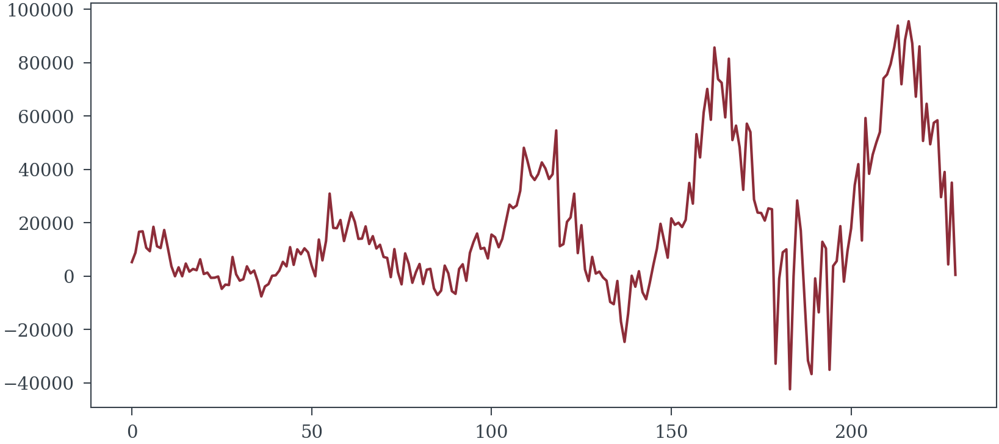

In [12]:
plt.plot((impressions*jax.nn.sigmoid(ctr_logit) 
          - (jax.nn.sigmoid(logit_ctr + 1*season.T[:, 0])
             *model_data["CP_Protein_Impressions"].values
             *np.exp(0.1*season.T[:,0])
             )))

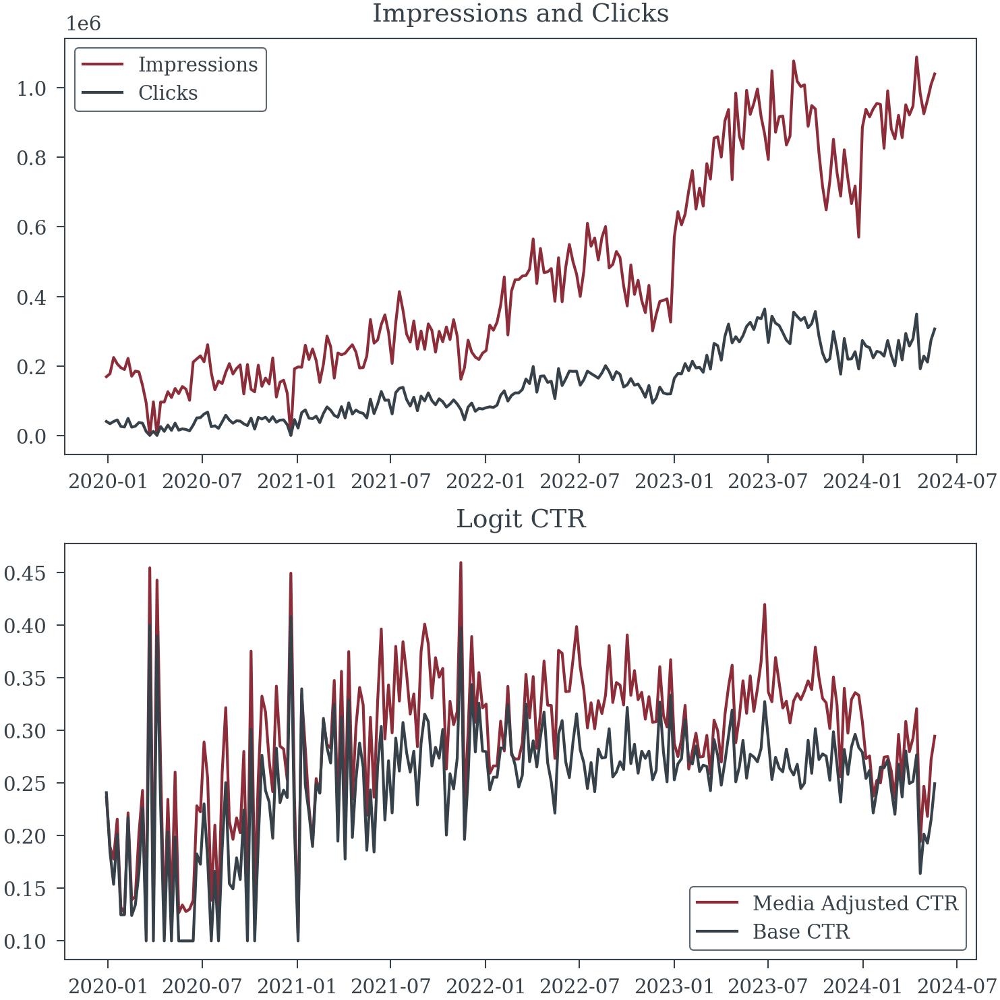

In [13]:
fig, ax = plt.subplots(2, figsize=(5, 5))
ax[0].plot(model_data["Week"], impressions, label="Impressions")
ax[0].plot(model_data["Week"], clicks, label="Clicks")
ax[0].legend()
ax[0].set_title("Impressions and Clicks")
ax[1].plot(model_data["Week"], jax.nn.sigmoid(ctr_logit), label="Media Adjusted CTR")
ax[1].plot(model_data["Week"], jax.nn.sigmoid(logit_ctr), label="Base CTR")
ax[1].legend()
ax[1].set_title("Logit CTR");

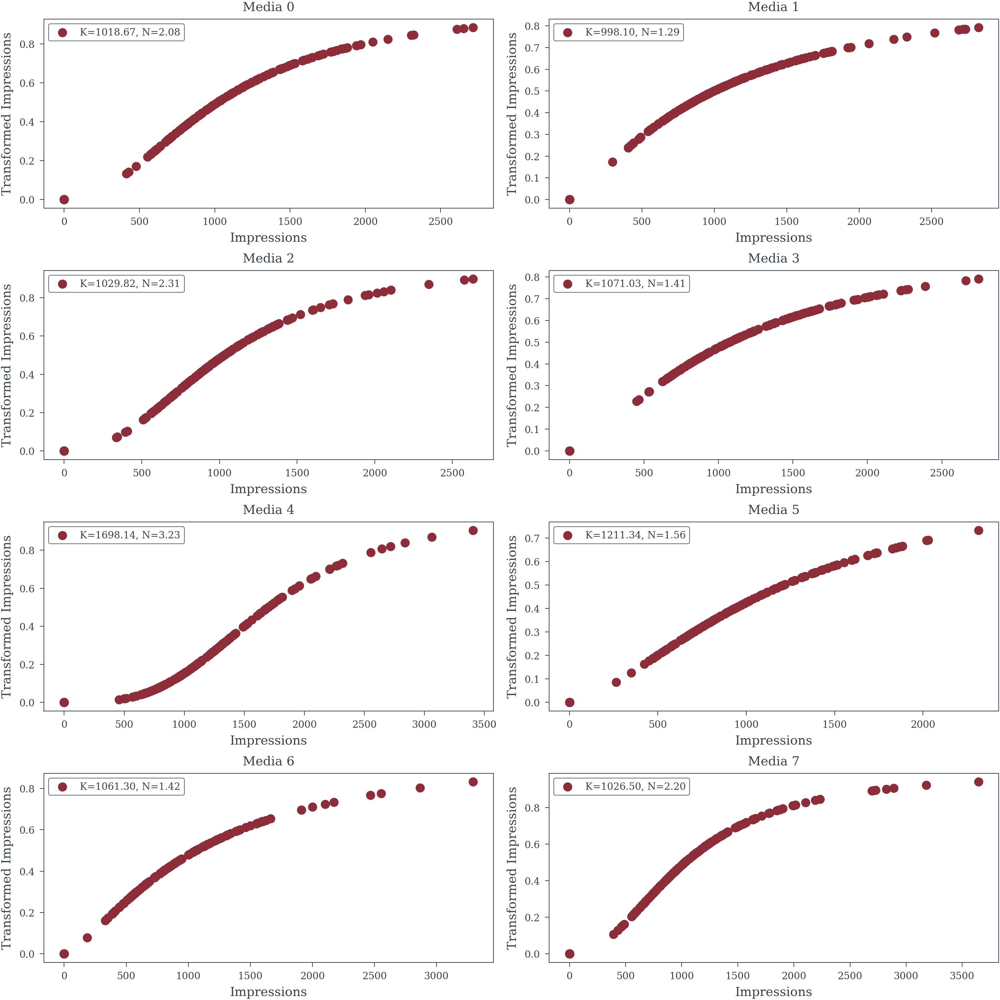

In [14]:
MEDIA_INDEX = 5
fig, ax = plt.subplots(N_MEDIA//2, 2, figsize=(10, 10))
for i in range(N_MEDIA):
  ax[i//2, i%2].scatter(media_data[:, i], media_shape_transformed_clicks[:, i], label=f"K={media_saturation_clicks[i]*media_data.mean(axis=0)[i]:.2f}, N={media_shape_clicks[i]:.2f}")
  ax[i//2, i%2].set_title(f"Media {i}")
  ax[i//2, i%2].set_xlabel("Impressions")
  ax[i//2, i%2].set_ylabel("Transformed Impressions")
  ax[i//2, i%2].legend();

In [15]:
def time_varying_intercept(time, period=52.18, model=None):
  model = pm.modelcontext(None)
  with model:
    
    intercept = pm.Normal("Intercept", 13, .4)
    
    short_term_ls = pm.InverseGamma("st_ell", mu=.25, sigma=.05)
    short_term_shape =pm.Gamma("st_shape", alpha=3, beta=1)
    short_term_var = pm.Exponential("st_var", 15)
    long_term_ls = pm.InverseGamma("lt_ell", mu=3.0, sigma=0.05)
    long_term_var = pm.Exponential("lt_var", 3)
    #period_ls = pm.InverseGamma("p_ell", mu=2, sigma=0.05)
    period_var = pm.Exponential("p_var", 10)
    #sigma = pm.HalfNormal("Sigma", .001)+1e-4
    
    period_kernel = Periodic(1, period, 2) * period_var #*ExpQuad(1, period_ls * period) * period_var
    short_term_kernel = RatQuad(1, short_term_shape, short_term_ls * period) * short_term_var
    long_term_kernel = ExpQuad(1, long_term_ls * period) * long_term_var
    #noise_kernel = WhiteNoise(sigma)
    
    constant = Constant(intercept)
    kernel = period_kernel + long_term_kernel + short_term_kernel #+ noise_kernel
    gp = Latent(mean_func=constant, cov_func=kernel)
    
    f = gp.prior("f", X=time[:, None])
    
    return f
  

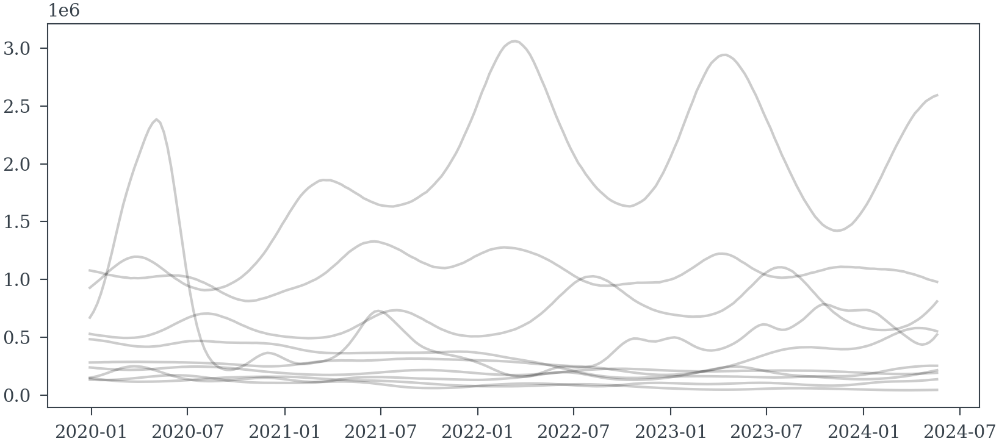

In [18]:
with pm.Model() as test:
  f = time_varying_intercept(model_data["Time"].values)
f_samples = pm.draw(f, 10)

plt.plot(model_data["Week"], np.exp(f_samples.T), color='k', alpha=.2);

In [19]:
f.shape.eval()

array([230])

In [20]:
np.log(impressions.mean())

13.052098084931798

In [21]:
import pytensor.tensor as pt

In [21]:
with pm.Model() as m:
  f = time_varying_intercept(model_data["Time"].values)
  alpha = pm.Exponential("alpha", 1)
  
  f_obs = pm.Normal(
    "f_obs",
    sigma=alpha,
    mu=pt.exp(f) + 1e-6,
    observed=(impressions)
  )
  
  trace = pm.sample(
    500, tune=100,
    cores=8, nuts_sampler='numpyro',
    target_accept=.95
  )

  0%|          | 0/600 [00:00<?, ?it/s]

  0%|          | 0/600 [00:00<?, ?it/s]

  0%|          | 0/600 [00:00<?, ?it/s]

  0%|          | 0/600 [00:00<?, ?it/s]

  0%|          | 0/600 [00:00<?, ?it/s]

  0%|          | 0/600 [00:00<?, ?it/s]

  0%|          | 0/600 [00:00<?, ?it/s]

  0%|          | 0/600 [00:00<?, ?it/s]

In [24]:
#trace.to_netcdf("data/trace.nc")

'data/trace.nc'

In [26]:
pm.plot_pair(trace, var_names=["~f", "~f_rotated_"])

array([[<Axes: ylabel='alpha'>, <Axes: >, <Axes: >, <Axes: >, <Axes: >,
        <Axes: >, <Axes: >],
       [<Axes: ylabel='lt_ell'>, <Axes: >, <Axes: >, <Axes: >, <Axes: >,
        <Axes: >, <Axes: >],
       [<Axes: ylabel='lt_var'>, <Axes: >, <Axes: >, <Axes: >, <Axes: >,
        <Axes: >, <Axes: >],
       [<Axes: ylabel='p_var'>, <Axes: >, <Axes: >, <Axes: >, <Axes: >,
        <Axes: >, <Axes: >],
       [<Axes: ylabel='st_ell'>, <Axes: >, <Axes: >, <Axes: >, <Axes: >,
        <Axes: >, <Axes: >],
       [<Axes: ylabel='st_shape'>, <Axes: >, <Axes: >, <Axes: >,
        <Axes: >, <Axes: >, <Axes: >],
       [<Axes: xlabel='Intercept', ylabel='st_var'>,
        <Axes: xlabel='alpha'>, <Axes: xlabel='lt_ell'>,
        <Axes: xlabel='lt_var'>, <Axes: xlabel='p_var'>,
        <Axes: xlabel='st_ell'>, <Axes: xlabel='st_shape'>]], dtype=object)

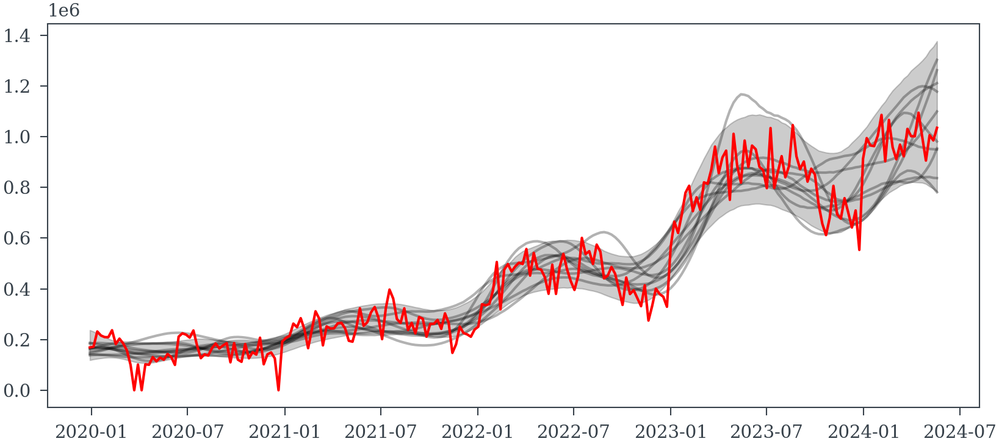

In [28]:
plt.plot(model_data["Week"], np.exp(trace.posterior['f'][0,:10, :].T), color='k', alpha=.3);
plt.plot(model_data["Week"], impressions, color='r');
plt.fill_between(model_data["Week"], np.exp(np.percentile(trace.posterior['f'], 2.5, axis=(0, 1))), np.exp(np.percentile(trace.posterior['f'], 97.5, axis=(0,1))), color='k', alpha=.2);

In [22]:
from patsy import dmatrix

In [23]:
model_data

,Week,Time,CP_Protein_Impressions,CP_Shake_Impressions
0,2019-12-29,0.0,169400,40813
1,2020-01-05,1.0,172196,31771
2,2020-01-12,2.0,209759,32265
3,2020-01-19,3.0,200685,40437
4,2020-01-26,4.0,191879,23945
...,...,...,...,...
225,2024-04-21,225.0,914393,149993
226,2024-04-28,226.0,841844,169691
227,2024-05-05,227.0,915311,176563
228,2024-05-12,228.0,915453,196886


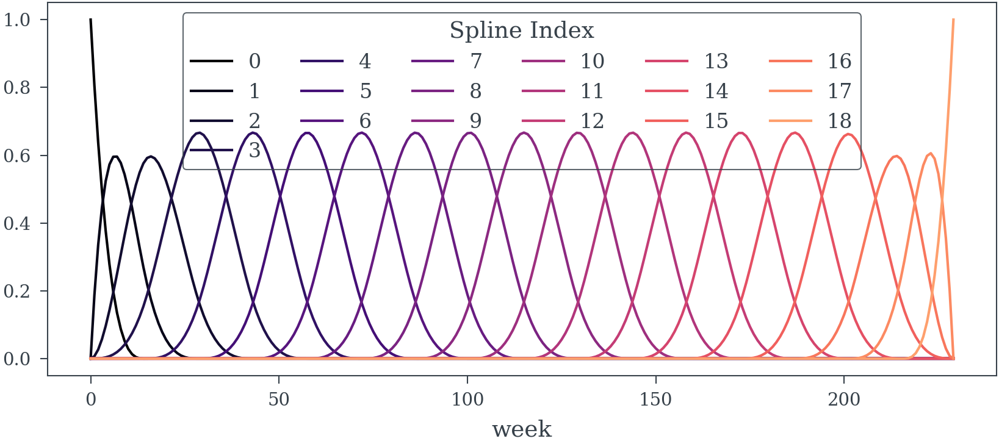

In [99]:
timescale = 13
knot_list = np.linspace(0, len(model_data), len(model_data)//timescale)

B = dmatrix(
    "bs(week, knots=knots, degree=3, include_intercept=True) - 1",
    {"week": model_data.Time.values, "knots": knot_list[1:-1]},
)
spline_df = (
    pd.DataFrame(B)
    .assign(week=model_data.Time.values)
    .melt("week", var_name="spline_i", value_name="value")
)
spline_df
color = plt.cm.magma(np.linspace(0, 0.80, len(spline_df.spline_i.unique())))
fig = plt.figure()
for i, c in enumerate(color):
    subset = spline_df.query(f"spline_i == {i}")
    subset.plot("week", "value", c=c, ax=plt.gca(), label=i)
plt.legend(title="Spline Index", loc="upper center", fontsize=8, ncol=6);


In [53]:
COORDS = {"splines": np.arange(B.shape[1])}
with pm.Model(coords=COORDS) as spline_model:
    a = pm.Normal("a", 13, 1)
    w = pm.Normal("w", mu=0, sigma=.2, dims=("splines",))
    
    trend = pm.Normal("trend", 0, 1)
    det_trend = trend*model_data.Time/len(model_data)
    mu = pm.Deterministic("mu", a + pm.math.dot(np.asarray(B, order="F"), w.T) + det_trend)
    alpha = pm.Exponential("alpha", .005)
    
    D = pm.NegativeBinomial("D", alpha=alpha, mu=np.exp(mu), observed=impressions)
    
    spline_sample = pm.sample(1000, tune=1000, cores=4, target_accept=.95, nuts_sampler='numpyro')

  0%|          | 0/2000 [00:00<?, ?it/s]

  0%|          | 0/2000 [00:00<?, ?it/s]

  0%|          | 0/2000 [00:00<?, ?it/s]

  0%|          | 0/2000 [00:00<?, ?it/s]

In [54]:
pm.summary(spline_sample, var_names=["~mu"])

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
a,11.822,0.099,11.641,12.013,0.002,0.001,2650.0,2688.0,1.0
alpha,5.069,0.479,4.148,5.955,0.007,0.005,4954.0,2905.0,1.0
trend,2.076,0.172,1.733,2.372,0.003,0.002,2458.0,2893.0,1.0
w[0],0.182,0.167,-0.144,0.485,0.002,0.002,4538.0,3150.0,1.0
w[1],0.068,0.168,-0.264,0.368,0.002,0.002,4694.0,2933.0,1.0
w[2],-0.257,0.170,-0.577,0.059,0.003,0.002,4070.0,2938.0,1.0
w[3],0.040,0.151,-0.226,0.336,0.002,0.002,4886.0,2871.0,1.0
w[4],-0.190,0.158,-0.499,0.094,0.002,0.002,4977.0,3459.0,1.0
w[5],-0.122,0.150,-0.397,0.157,0.002,0.002,4576.0,3136.0,1.0
w[6],0.044,0.153,-0.249,0.324,0.002,0.002,4596.0,3159.0,1.0


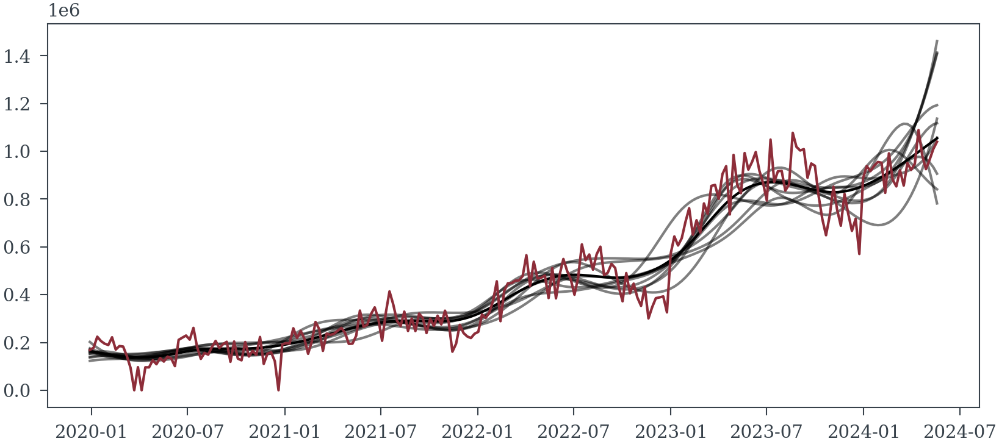

In [55]:
plt.plot(model_data["Week"], np.exp(spline_sample.posterior["mu"].mean(axis=(0, 1))),c='k', label="Spline Model")
plt.plot(model_data["Week"], np.exp(spline_sample.posterior["mu"][0, :10, :]).T,c='k', alpha=.5, label="GP Model")
plt.plot(model_data["Week"], impressions, label="GP Model")

In [56]:
m_

array([[-0.10279844],
       [-0.10662941],
       [-0.18599856],
       [ 0.06809071],
       [ 0.11102792],
       [-0.34157572],
       [-0.5280688 ],
       [-0.07190151]])

In [57]:
pm.summary(spline_sample, var_names=["w", 'a', 'trend'])

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
w[0],0.182,0.167,-0.144,0.485,0.002,0.002,4538.0,3150.0,1.0
w[1],0.068,0.168,-0.264,0.368,0.002,0.002,4694.0,2933.0,1.0
w[2],-0.257,0.170,-0.577,0.059,0.003,0.002,4070.0,2938.0,1.0
w[3],0.040,0.151,-0.226,0.336,0.002,0.002,4886.0,2871.0,1.0
w[4],-0.190,0.158,-0.499,0.094,0.002,0.002,4977.0,3459.0,1.0
w[5],-0.122,0.150,-0.397,0.157,0.002,0.002,4576.0,3136.0,1.0
w[6],0.044,0.153,-0.249,0.324,0.002,0.002,4596.0,3159.0,1.0
w[7],0.015,0.147,-0.253,0.298,0.002,0.002,5113.0,3154.0,1.0
w[8],-0.217,0.152,-0.510,0.053,0.002,0.002,4842.0,2711.0,1.0
w[9],0.095,0.146,-0.174,0.362,0.002,0.002,5042.0,2917.0,1.0


In [30]:
pm.model_to_graphviz(m)

NameError: name 'm' is not defined

In [145]:
trace.to_netcdf("trace_sample.nc")

'trace_sample.nc'

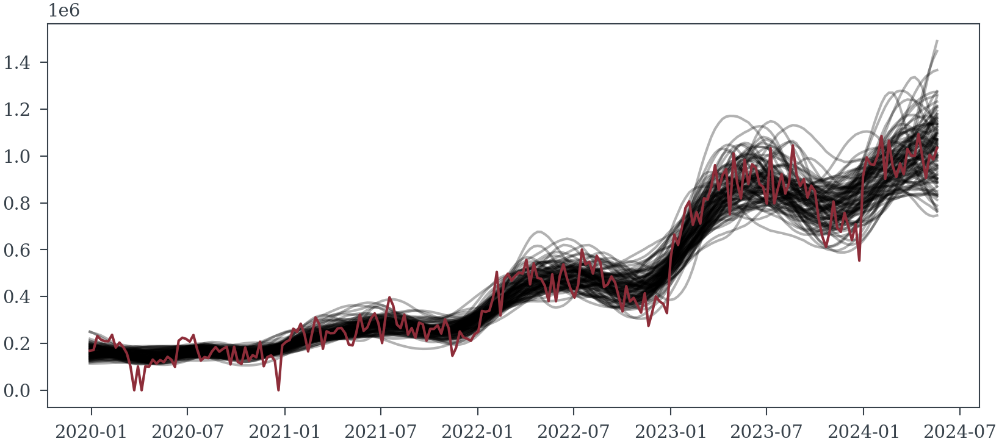

In [146]:
plt.plot(model_data["Week"], np.exp(trace.posterior["f"][0, ::5, :].T), alpha=.3, color='k')
plt.plot(model_data["Week"], impressions)

In [58]:
def make_fourier(n, time, period=52.18):
 
  
  sines = [np.sin(2*np.pi*(i+1)*time/period)/(2*(i+1)**1.4) for i in range(n)]
  cosines = [np.cos(2*np.pi*(i+1)*time/period)/(2*(i+1)**1.4) for i in range(n)]
  return np.vstack(sines + cosines)


In [59]:
make_fourier(5, model_data["Time"].values).shape

(10, 230)

In [106]:
fourier_terms = make_fourier(4, model_data["Time"].values)

coords = {
  'date': model_data["Week"],
  'media': [f"Media_{i}" for i in range(N_MEDIA)],
  'effect_type': ['Impressions', 'CTR'],
  "splines": np.arange(B.shape[1]),
  "fourier": np.arange(8)
}

with pm.Model(coords=coords) as model:
  media_data_pm = pm.Data('media_data', media_data, dims=('date', 'media'))
  # Define priors
  season_betas = pm.Normal('season_betas', mu=0, sigma=.2, dims=('fourier'))
  media_betas_imps = pm.HalfNormal('media_betas', sigma=.05, dims=('media'))
  media_saturation_mus = pm.Uniform('media_saturation_mus', 1.0, 2.4, dims='media')
  #media_saturation_sigmas = pm.HalfNormal('media_saturation_sigmas', .2, dims='media')
  #media_saturation_imps = pm.TruncatedNormal('media_saturation_imps', 
  #                                      mu=media_saturation_mus, 
  #                                      sigma=media_saturation_sigmas, 
  #                                      lower=1, 
  #                                      upper=2.4, 
  #                                      dims=('media'))
  media_shape_mus = pm.Uniform('media_shape_mus', 0.9, 4, dims='media')
  #media_shape_sigmas = pm.HalfNormal('media_shape_sigmas', .01, dims='media')
  #media_shape_imps = pm.TruncatedNormal('media_shape_imps', 
  #                                 mu=media_shape_mus, 
  #                                 sigma=media_shape_sigmas, 
  #                                 lower=0.9, 
  #                                 upper=3, 
  #                                 dims=('media'))
  media_saturation_curves_imps = pm.Deterministic('media_saturation_curves_imps', 
                                             shape.hill_function((media_data_pm/media_data_pm.mean(axis=0)),
                                                                 media_saturation_mus.T,
                                                                 media_shape_mus.T), 
                                             dims=('date', 'media'))
  
  media_lags = pm.Uniform('media_lags', 0, 2, dims='media')
  media_carryover = pm.Uniform('media_carryover', 0.0001, .25, dims='media')
  
  media_adstock_imps = pm.Deterministic('media_adstock_imps',
                                    adstock.delayed_adstock(media_saturation_curves_imps, 
                                                           alpha=media_carryover, 
                                                           theta=media_lags,
                                    ), dims=('date', 'media'))
  
  media_contributions_imp = pm.Deterministic('media_contributions_imps', 
                                         (media_adstock_imps*media_betas_imps).sum(axis=1), 
                                         dims=('date'))
  
  
  base_lam_imp= pm.Normal('base_lam_imp', mu=6, sigma=3)
 
  w_imps = pm.Normal("w_imps", mu=0, sigma=.5, dims=("splines"))
    
  trend_imps = pm.Normal("trend_imps", 0, 1)
  
  short_trend_imps = pm.Deterministic("short_trend_imps", 
                                      pm.math.sum(np.asarray(B, order="F")*w_imps, axis=1),
                                      dims=('date'))
  
  mu_imp = pm.Deterministic("mu_imps", 
                            base_lam_imp 
                            + short_trend_imps 
                            + trend_imps*model_data.Time.values/len(model_data)
                            + season_betas @ fourier_terms 
                            , dims=('date'))
  
  alpha = pm.Exponential("alpha", .1)
  
  mean_estimate = pm.Deterministic('mean_estimate', (media_contributions_imp + mu_imp), dims=('date'))
  impressions_sampled = pm.NegativeBinomial('impressions',
                                            alpha=alpha,
                                            mu=pt.exp(mean_estimate),
                                            dims=('date'), observed=impressions)
  
  
  #clicks_sampled = pm.Binomial('clicks', 
  ##                             n=impressions_sampled, 
  #                             p=pm.math.sigmoid(mean_estimate[:, 1]), 
  #                             dims=('date'), observed=clicks)
  

  impressions_spline_trace = pm.sample(1000, tune=1000, cores=4, 
                                       target_accept=.95, nuts_sampler='numpyro')


  0%|          | 0/2000 [00:00<?, ?it/s]

  0%|          | 0/2000 [00:00<?, ?it/s]

  0%|          | 0/2000 [00:00<?, ?it/s]

  0%|          | 0/2000 [00:00<?, ?it/s]

In [107]:
pm.summary(impressions_spline_trace, var_names=["~media_saturation_curves_imps", "~media_adstock_imps", "~media_contributions_imps", "~mu_imps", "~short_trend_imps", "~mean_estimate", "~w_imps"])

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
alpha,5.273,0.502,4.358,6.217,0.006,0.005,6465.0,2465.0,1.00
base_lam_imp,11.811,0.216,11.410,12.222,0.005,0.003,2038.0,2692.0,1.00
media_betas[Media_0],0.037,0.028,0.000,0.089,0.000,0.000,3107.0,2016.0,1.00
media_betas[Media_1],0.041,0.030,0.000,0.093,0.000,0.000,3680.0,1966.0,1.00
media_betas[Media_2],0.041,0.030,0.000,0.096,0.000,0.000,3009.0,1679.0,1.00
media_betas[Media_3],0.036,0.028,0.000,0.087,0.000,0.000,4062.0,2083.0,1.00
media_betas[Media_4],0.040,0.031,0.000,0.095,0.000,0.000,3229.0,1807.0,1.00
media_betas[Media_5],0.037,0.028,0.000,0.089,0.000,0.000,3415.0,1991.0,1.00
media_betas[Media_6],0.034,0.027,0.000,0.083,0.000,0.000,3100.0,1697.0,1.00
media_betas[Media_7],0.041,0.030,0.000,0.095,0.000,0.000,3765.0,1884.0,1.00


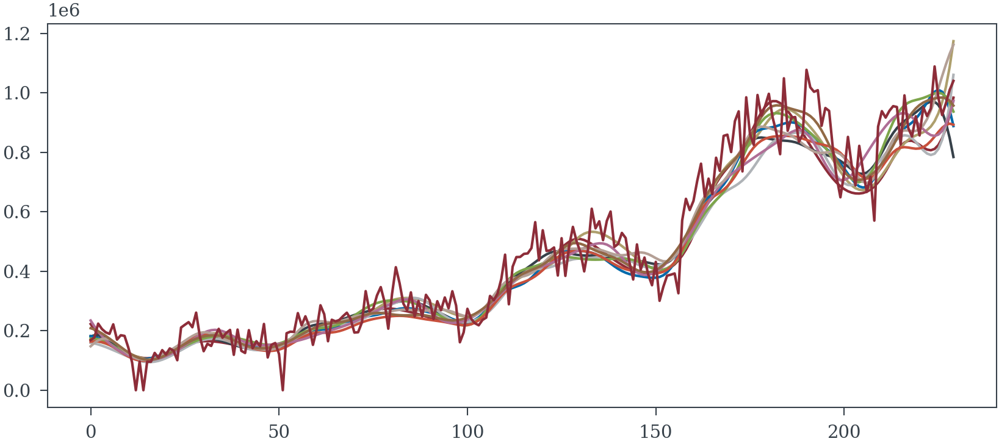

In [108]:
plt.plot(np.exp(impressions_spline_trace.posterior['mu_imps'].mean(axis=(0)).values[:10,:].T))
plt.plot(impressions)

In [109]:
pm.summary(impressions_spline_trace, var_names=['media_betas', 'media_saturation_mus', 'media_shape_mus'])

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
media_betas[Media_0],0.037,0.028,0.000,0.089,0.000,0.000,3107.0,2016.0,1.00
media_betas[Media_1],0.041,0.030,0.000,0.093,0.000,0.000,3680.0,1966.0,1.00
media_betas[Media_2],0.041,0.030,0.000,0.096,0.000,0.000,3009.0,1679.0,1.00
media_betas[Media_3],0.036,0.028,0.000,0.087,0.000,0.000,4062.0,2083.0,1.00
media_betas[Media_4],0.040,0.031,0.000,0.095,0.000,0.000,3229.0,1807.0,1.00
media_betas[Media_5],0.037,0.028,0.000,0.089,0.000,0.000,3415.0,1991.0,1.00
media_betas[Media_6],0.034,0.027,0.000,0.083,0.000,0.000,3100.0,1697.0,1.00
media_betas[Media_7],0.041,0.030,0.000,0.095,0.000,0.000,3765.0,1884.0,1.00
media_saturation_mus[Media_0],1.694,0.400,1.070,2.378,0.004,0.003,10698.0,2432.0,1.00
media_saturation_mus[Media_1],1.697,0.407,1.000,2.319,0.004,0.003,8902.0,2459.0,1.00


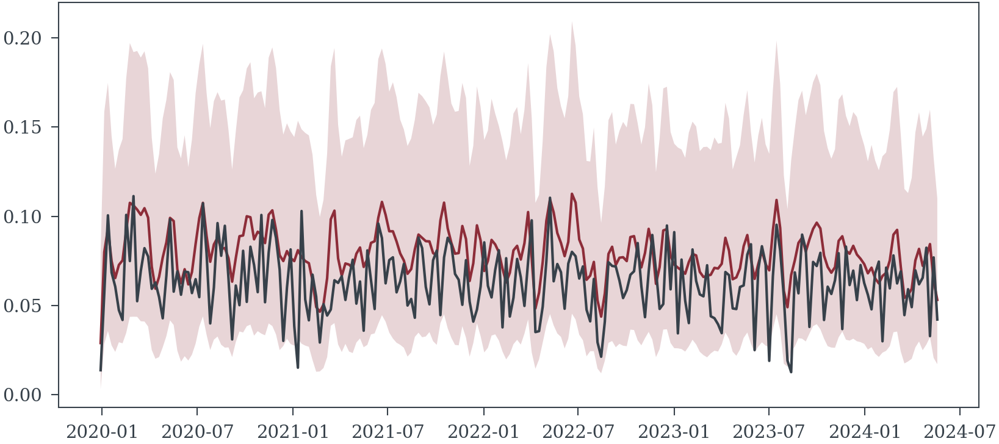

In [110]:
plt.plot(model_data["Week"], impressions_spline_trace.posterior['media_contributions_imps'].mean(axis=(0, 1)).values)
plt.fill_between(model_data["Week"], 
                 np.percentile(impressions_spline_trace.posterior['media_contributions_imps'], 2.5, axis=(0, 1)),
                 np.percentile(impressions_spline_trace.posterior['media_contributions_imps'], 97.5, axis=(0, 1)), alpha=.2)
plt.plot(model_data["Week"], media_effect_imps)

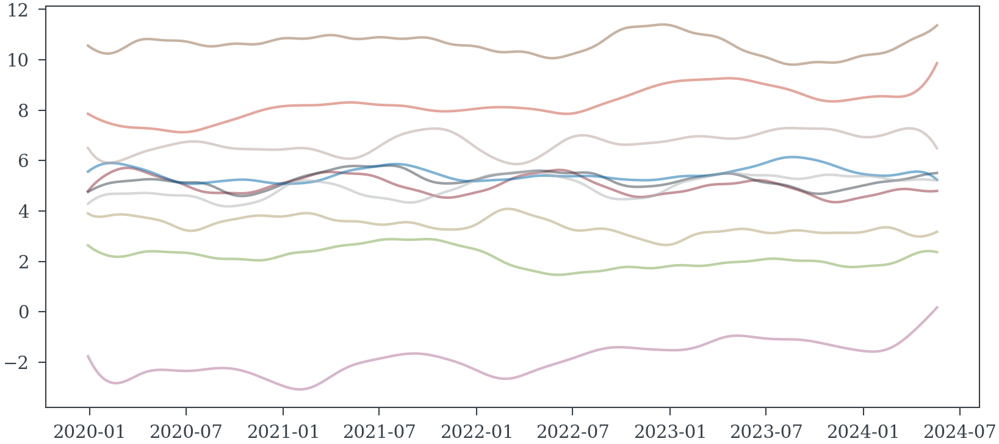

In [112]:
draws = pm.draw(mu_imp, 10)
plt.plot(model_data["Week"], draws.T, alpha=0.5)

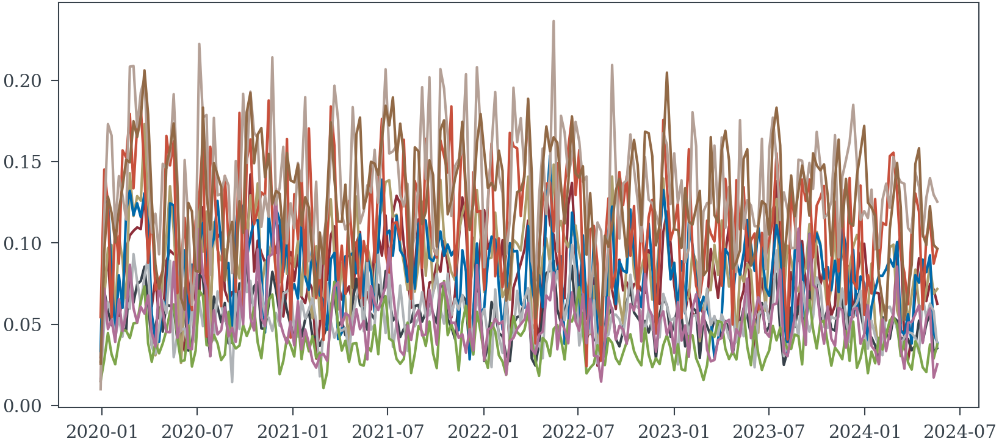

In [114]:
draws = pm.draw(media_contributions_imp, 10)
plt.plot(model_data["Week"], draws[:, :].T)

In [115]:
draws = pm.draw(media_saturation_curves_imps, 10)

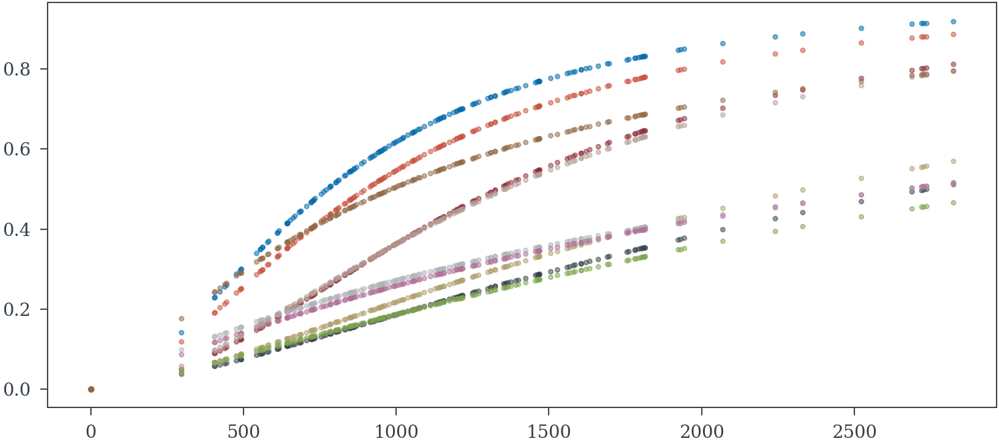

In [121]:
CHANNEL = 1
index = np.array(sorted(([[i, value] for i, value in enumerate(media_data[:, CHANNEL])]), key=lambda x: x[1]))[:,0]
for draw in draws:
  plt.scatter(media_data[index, CHANNEL], draw[index, CHANNEL].T, alpha=0.5, s=3);

#plt.plot(media_data[index, CHANNEL], draws[:,index, CHANNEL].T, c='r', alpha=0.5);

In [122]:
def plot_shaded(x, gp, color="gray", alpha=0.5, ax = None, name=None, x_data=None):
    if ax is None:
        fig, ax = plt.subplots(figsize=(12, 6))
    if x_data is None:
        x_data = x[:, 0]
    ax.fill_between(x_data, gp(x).mu - 2*gp(x).std, gp(x).mu + 2*gp(x).std, color=color, alpha=alpha)
    ax.plot(x_data, gp(x).mu, color="black")
    ax.plot(x_data, gp(x).mu - 2*gp(x).std, color="black", linestyle="--")
    ax.plot(x_data, gp(x).mu + 2*gp(x).std, color="black", linestyle="--")
    ax.legend(["Mean", "Lower 95% CI", "Upper 95% CI"])
    if name is not None:
        ax.set_ylabel(name)
    return ax

In [123]:
clean_cp = cp_terms
y = jnp.array(clean_cp["Core Power Protein"], dtype=jnp.float64)
time_clean = jnp.array(clean_cp["Time"], dtype=jnp.float64)[:, None]
y_mean = jnp.mean(y)

constant_mean = lambda x: jnp.ones(len(x), dtype=jnp.float64)*y_mean
zero_mean = lambda x: jnp.zeros_like(x[..., 0])

In [124]:
def make_model_kernel(params):
  (
    l_long,
    theta_long,
    l_short,
    shape_short,
    theta_short,
    l_month,
    theta_month,
    l_yearly_periodic,
    theta_yearly_periodic,
    noise_theta
  ) = params
  
  long_term_trend = gp.SEKernel(l_long, theta=theta_long)
  short_term_trend = gp.RQKernel(l_short, alpha=shape_short, theta=theta_short)
  month_trend = gp.SEKernel(l_month, theta=theta_month)
  periodic = gp.PeriodicKernel(length_scale=1/2., period=52.18, theta=1)*gp.SEKernel(length_scale=l_yearly_periodic, theta=theta_yearly_periodic)
  noise = gp.WhiteNoiseKernel(noise_theta)*periodic + gp.WhiteNoiseKernel(noise_theta)*month_trend
  season = (periodic)*(long_term_trend)
  return long_term_trend + season  + noise

def return_kernels(params):
  (
    l_long,
    theta_long,
    l_short,
    shape_short,
    theta_short,
    l_month,
    theta_month,
    l_yearly_periodic,
    theta_yearly_periodic,
    noise_theta
  ) = params
  long_term_trend = gp.SEKernel(l_long, theta=theta_long)
  short_term_trend = gp.RQKernel(l_short, alpha=shape_short, theta=theta_short)
  month_trend = gp.SEKernel(l_month, theta=theta_month)
  periodic = gp.PeriodicKernel(length_scale=1, period=52.18, theta=1)*gp.SEKernel(length_scale=l_yearly_periodic, theta=theta_yearly_periodic)
  noise = gp.WhiteNoiseKernel(noise_theta)*periodic + gp.WhiteNoiseKernel(noise_theta)*month_trend
  
  trend = long_term_trend + short_term_trend 
  season = periodic*(long_term_trend + short_term_trend)
  return trend, season, noise

In [125]:
initial_params = jnp.array(
  [
    52*6, 
    30, 
    52, 
    5, 
    3,
    4,
    2, 
    52*4, 
    10, 
    .1
  ]
)

def NegEvidence(params):
  kernel = make_model_kernel(params)
  m = constant_mean
  gp_model = gp.GaussianProcess(m, kernel)
  
  return -gp_model(time_clean).logpdf(y)

jac = grad(NegEvidence)

results = results = optimize.minimize(
  NegEvidence,
  initial_params,
  method="CG",
  jac = jac,
  options={"gtol": 1e-7, 'disp': True, "maxiter":500}
)

In [11]:
#long_term_trend = gp.SEKernel(length_scale=52*6, theta=30)
#yearly_periodic = gp.PeriodicKernel(length_scale=1, period=52.18, theta=1)*gp.SEKernel(length_scale=66, theta=.15)
#yl_trend = gp.RQKernel(length_scale=52, theta=5, alpha=3)
#noise = gp.WhiteNoiseKernel(2)#*gp.SEKernel(length_scale=2, theta=1)

#seasonal_trend = (yearly_periodic)*(long_term_trend+yl_trend)

#gp_search = gp.GaussianProcess(constant_mean, seasonal_trend + noise + long_term_trend + yl_trend)
trend, season, noise = return_kernels(results.x)
gp_search = gp.GaussianProcess(constant_mean, make_model_kernel(results.x))
samples = gp_search(time_plus).sample(jax.random.PRNGKey(0), 3)
conditioned_search = gp_search.condition(time_clean[:-50, :], y[:-50], 1)
conditioned_samples = conditioned_search(time_plus).sample(jax.random.PRNGKey(0), 3)

<Axes: >

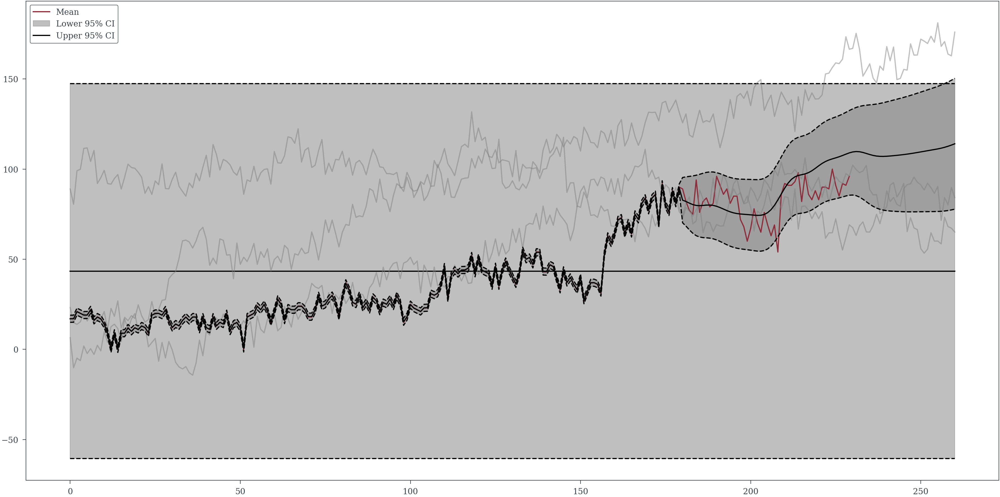

In [12]:
fig, ax = plt.subplots(figsize=(12, 6))
ax.plot(time_clean, y)
plot_shaded(time_plus, gp_search, ax=ax)
ax.plot(time_plus, samples.T, color="gray", alpha=0.5)
plot_shaded(time_plus, conditioned_search, ax=ax)


In [13]:
zero_mean = lambda x: jnp.zeros_like(x[..., 0])
seasonal_trend = results.x
yearly_periodic_gp = conditioned_search.project(season, zero_mean)
linear_trend_gp = conditioned_search.project(trend, constant_mean)
noise_gp = conditioned_search.project(noise, zero_mean)

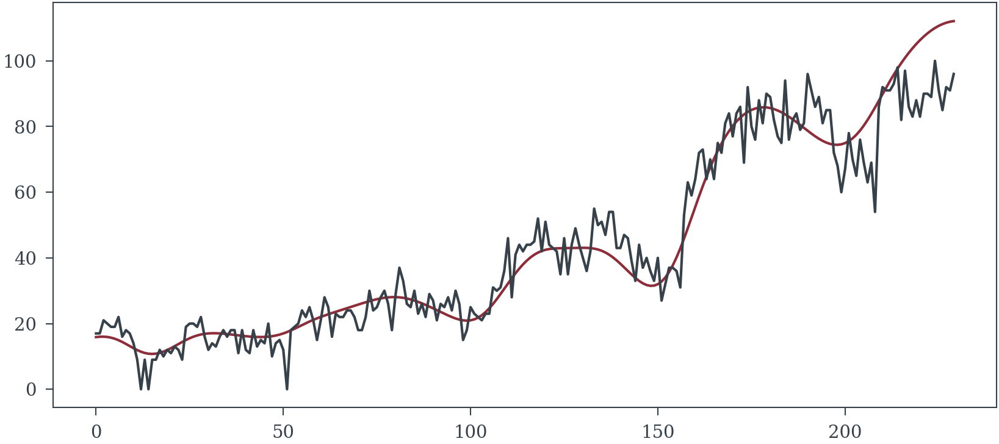

In [14]:
plt.plot(yearly_periodic_gp(time).mu+ linear_trend_gp(time).mu )
plt.plot(time[:, 0], y)

In [15]:
i = 1
linear_mus = linear_trend_gp(time).mu + yearly_periodic_gp(time).mu
(linear_mus[52*i:52*(i+1)].sum()-linear_mus[52*(i-1):52*i].sum())/(linear_mus[52*(i-1):52*i].sum())

Array(0.60288658, dtype=float64)

In [16]:
linear_trend_gp(time).Sigma

Array([[ 10.85318123,  10.56799431,  10.28494542, ...,   2.44004316,
          2.46824011,   2.49570017],
       [ 10.56799431,  10.29611215,  10.02615618, ...,   2.39201829,
          2.42129772,   2.44988928],
       [ 10.28494542,  10.02615618,   9.76908967, ...,   2.34156079,
          2.37184062,   2.40148071],
       ...,
       [  2.44004316,   2.39201829,   2.34156079, ...,  93.93204336,
         95.5713845 ,  97.21314318],
       [  2.46824011,   2.42129772,   2.37184062, ...,  95.5713845 ,
         97.24758665,  98.92643714],
       [  2.49570017,   2.44988928,   2.40148071, ...,  97.21314318,
         98.92643714, 100.64261877]], dtype=float64)

In [17]:
np.array(linear_mus.tolist()).shape

(230,)

<Axes: ylabel='Qrt Periodic'>

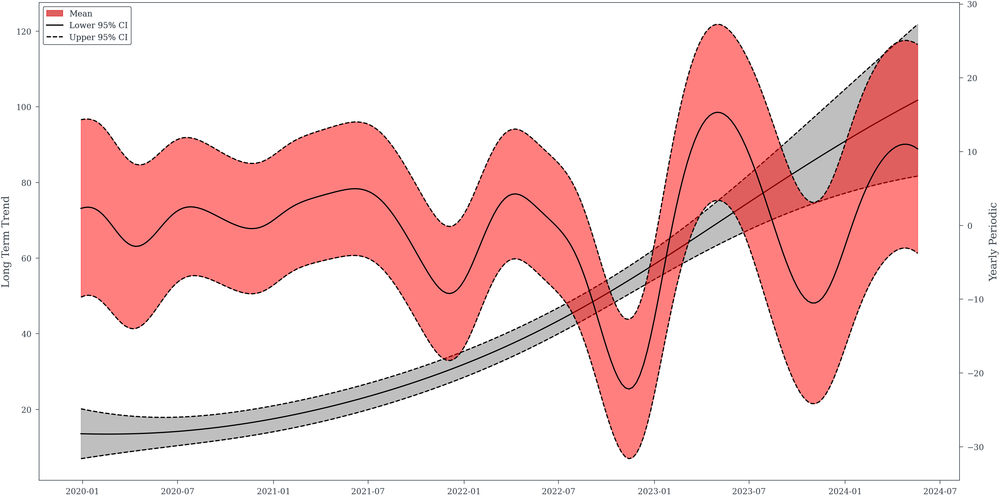

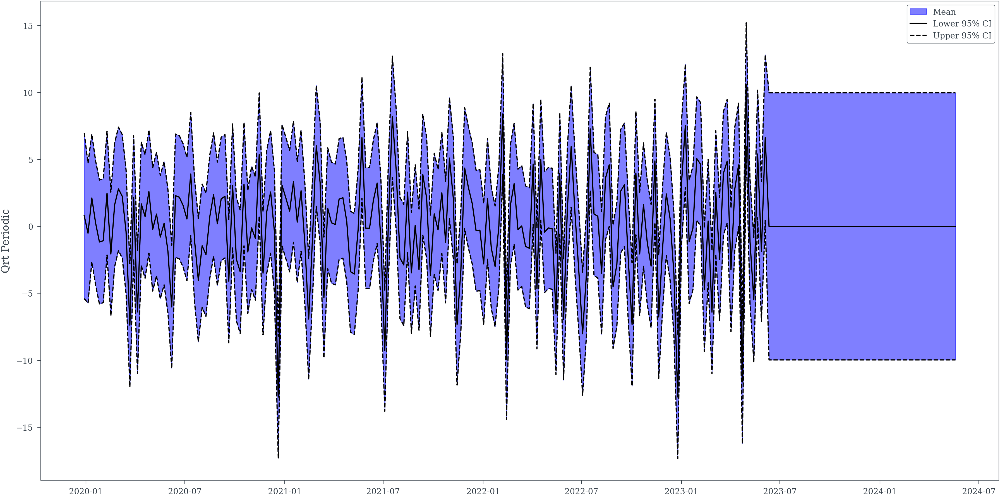

In [18]:
dates = pd.date_range(cp_terms['Week'].min(), periods=len(time), freq="W")
ax=plot_shaded(time, linear_trend_gp, name="Long Term Trend", x_data=dates)
ax1 = ax.twinx()
plot_shaded(time, yearly_periodic_gp, ax=ax1, color="red", name="Yearly Periodic", x_data=dates)

plot_shaded(time, noise_gp, color="blue", name="Qrt Periodic", x_data=dates)

In [19]:
import pymc as pm

In [20]:
def make_model_kernel(params):
  (
    l_long,
    theta_long,
    l_short,
    shape_short,
    theta_short,
    l_month,
    theta_month,
    l_yearly_periodic,
    theta_yearly_periodic,
    noise_theta
  ) = params
  
  long_term_trend = gp.SEKernel(l_long, theta=theta_long)
  short_term_trend = gp.RQKernel(l_short, alpha=shape_short, theta=theta_short)
  month_trend = gp.SEKernel(l_month, theta=theta_month)
  periodic = gp.PeriodicKernel(length_scale=1/2., period=52.18, theta=1)*gp.SEKernel(length_scale=l_yearly_periodic, theta=theta_yearly_periodic)
  noise = gp.WhiteNoiseKernel(noise_theta)*periodic + gp.WhiteNoiseKernel(noise_theta)*month_trend
  season = (periodic)*(long_term_trend)
  return long_term_trend + season  + noise



In [21]:
import pymc as pm
from utils import media_transforms

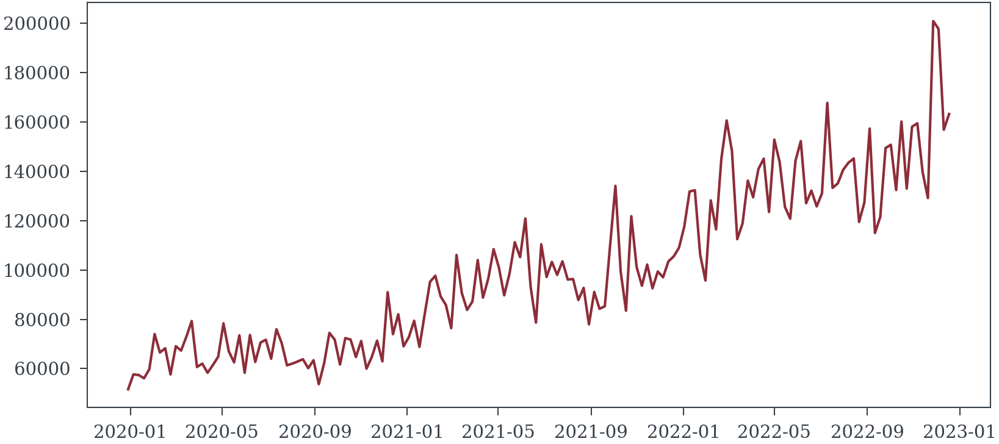

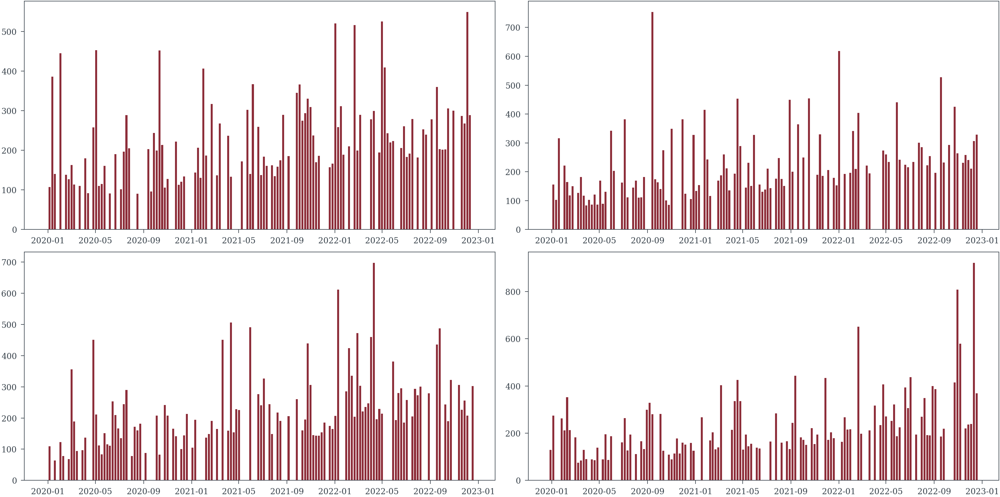

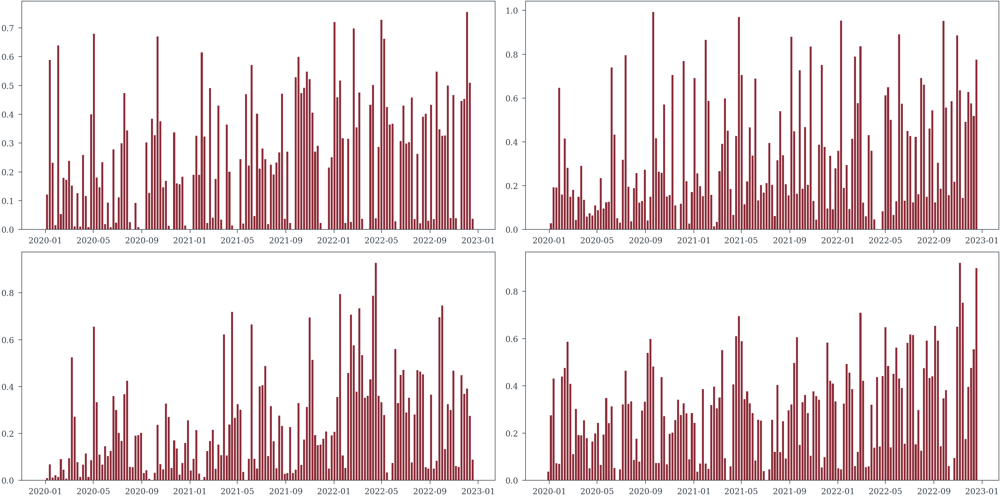

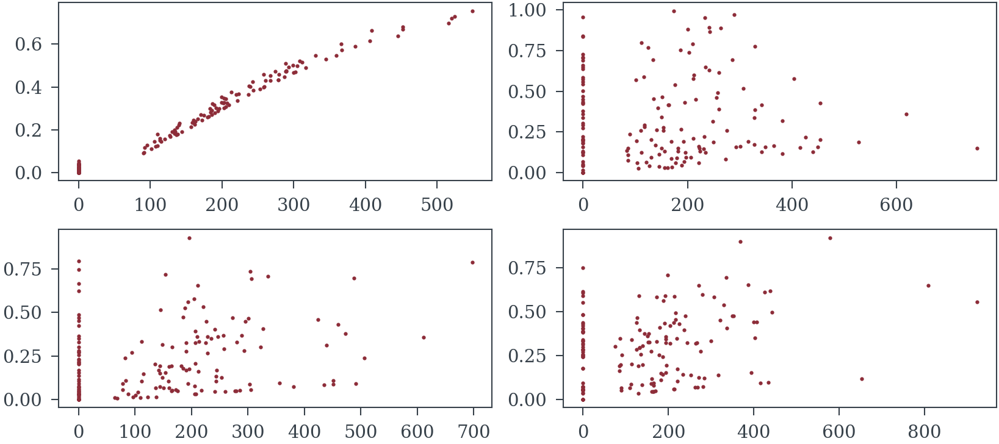

In [22]:
np.random.seed(0)
t = np.arange(0, 156)
media_vars = (np.random.exponential(100, (156, 4)) + 50 + 10*np.sin(2*np.pi*t[:, np.newaxis]/52.8) + t[:, np.newaxis]) * np.random.binomial(1, 0.70, size=(156, 4))
dates = pd.date_range(cp_terms['Week'].min(), periods=156, freq="W")
K_t = np.random.uniform(.2, .6, size=(4,))
n_t = np.random.uniform(1, 3, size=(4,))
decay_t = np.random.uniform(0.0, 0.2, size=(4,))
delay_t = np.random.choice([0, 1], p=[.3, .7], size=(4,))
media_vars_transformed = media_transforms.shape.hill_function(media_vars/media_vars.max(axis=0), n_t, K_t)
media_vars_transformed = media_transforms.adstock.delayed_adstock(media_vars_transformed, decay_t, delay_t, l_max=20).eval()

betas_media_t = np.random.uniform(0.02, .15, size=(4,))
sales = 50000*np.exp(.1*np.sin(2*np.pi*t/52.8) + t/156 + betas_media_t @ media_vars_transformed.T + np.random.normal(0, .1, 156))
plt.plot(dates, sales)
fig, ax = plt.subplots(2, 2, figsize=(12, 6))
for i in range(4):
    ax[i//2, i%2].bar(dates, media_vars[:, i], width=5)
fig, ax = plt.subplots(2, 2, figsize=(12, 6))
for i in range(4): 
    ax[i//2, i%2].bar(dates, media_vars_transformed[:, i], width=5)
media_effects_t = betas_media_t * media_vars_transformed
fig, ax = plt.subplots(2, 2)
ax[0, 0].scatter(media_vars[:, 0], media_vars_transformed[:, 0], s=1)
ax[0, 1].scatter(media_vars[:, 1], media_vars_transformed[:, 1], s=1)
ax[1, 0].scatter(media_vars[:, 2], media_vars_transformed[:, 2], s=1)
ax[1, 1].scatter(media_vars[:, 3], media_vars_transformed[:, 3], s=1)

In [23]:
RSS = (((.1*np.sin(2*np.pi*t/52.8) + t/156 + betas_media_t @ media_vars_transformed.T + np.log(50000))-np.log(sales))**2).mean()
TSS = ((np.log(sales) - np.log(sales).mean())**2).mean()
1 - RSS/TSS

0.9240657381271731

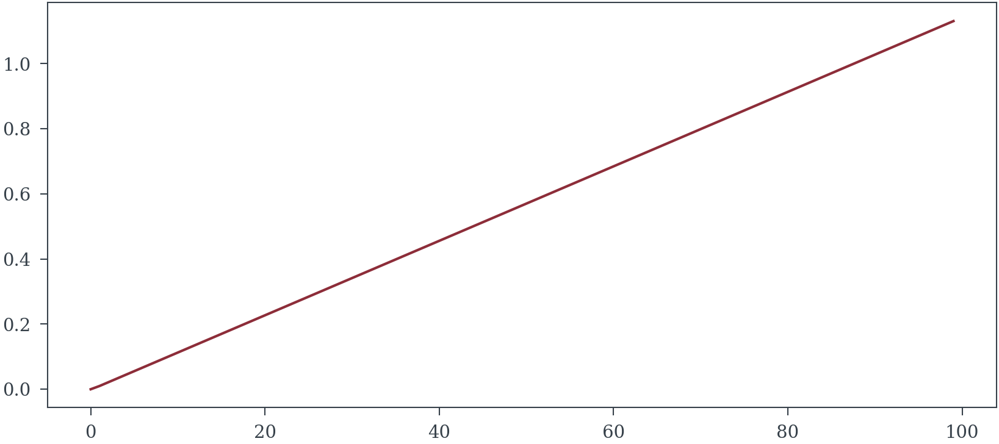

In [24]:
x = np.linspace(0, 1, 100)[:, None]
plt.plot(media_transforms.adstock.delayed_adstock(x, .1, .1, l_max=20).eval())

In [33]:
coords = {
    "media": ["TV", "Radio", "Social", "Search"],
    "date": dates
}
with pm.Model(coords=coords) as model:
  betas_media = pm.HalfNormal("betas_media", 4, dims="media")
  K = pm.Uniform("K", .1, 1.2, dims="media")
  n = pm.Uniform("n", .8, 3, dims="media")
  decay = pm.Uniform("decay", 0.001, 0.3, dims="media")
  delay = pm.Uniform("delay", 0, 2, dims="media")
  media_effect = pm.Deterministic("media_effect", betas_media * media_transforms.adstock.delayed_adstock(
    media_transforms.shape.hill_function(media_vars/media_vars.max(axis=0), n, K), 
    decay, delay, l_max=20
    ), 
  dims=("date", "media"))
  total_media_effect = pm.Deterministic("total_media_effect", media_effect.sum(axis=1), dims="date")
  
  slope = pm.Normal("slope", 0, 1)
  season_beta = pm.Normal("season_beta", 0, 1)
  intercept = pm.Normal("intercept", 0, 10)
  
  sigma = pm.Exponential("sigma", 1)
  mu = intercept + slope*t + season_beta*np.sin(2*np.pi*t/52.8) + total_media_effect
  sales_m = pm.Normal("sales", mu, sigma, observed=np.log(sales))
  trace = pm.sample(2000, tune=2000, target_accept=.95, nuts_sampler='numpyro')
  
  
  

  0%|          | 0/4000 [00:00<?, ?it/s]

  0%|          | 0/4000 [00:00<?, ?it/s]

  0%|          | 0/4000 [00:00<?, ?it/s]

  0%|          | 0/4000 [00:00<?, ?it/s]

In [38]:
(betas_media_t,
K_t,
n_t,
decay_t,
delay_t)

(array([0.14415607, 0.14730722, 0.13200683, 0.06668262]),
 array([0.58870523, 0.34553791, 0.5151663 , 0.42211764]),
 array([1.79126734, 2.91093187, 2.19663194, 1.23783388]),
 array([0.08350784, 0.15631635, 0.1387494 , 0.18326807]),
 array([0, 1, 1, 1]))

In [39]:
pm.summary(trace, var_names=["betas_media", "K", "n", "decay", "delay", "slope", "season_beta", "intercept", "sigma"])

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
betas_media[TV],0.308,0.121,0.099,0.520,0.002,0.001,5475.0,5011.0,1.0
betas_media[Radio],0.415,0.213,0.099,0.782,0.003,0.002,4636.0,5650.0,1.0
betas_media[Social],0.197,0.117,0.024,0.408,0.002,0.001,4672.0,3733.0,1.0
betas_media[Search],0.239,0.162,0.000,0.518,0.002,0.002,3971.0,3038.0,1.0
K[TV],0.851,0.246,0.417,1.200,0.003,0.002,5898.0,4297.0,1.0
K[Radio],0.788,0.248,0.402,1.200,0.003,0.002,5064.0,4820.0,1.0
K[Social],0.768,0.284,0.295,1.200,0.003,0.002,6350.0,5009.0,1.0
K[Search],0.863,0.249,0.411,1.200,0.003,0.002,6775.0,4759.0,1.0
n[TV],1.700,0.533,0.820,2.676,0.006,0.004,8055.0,4861.0,1.0
n[Radio],2.003,0.483,1.195,2.920,0.006,0.004,6543.0,4435.0,1.0


In [40]:
with model:
  ppc = pm.sample_posterior_predictive(trace, var_names=["sales"])

Sampling: [sales]


array([[<Axes: title={'center': 'betas_media'}>,
        <Axes: title={'center': 'betas_media'}>],
       [<Axes: title={'center': 'K'}>, <Axes: title={'center': 'K'}>],
       [<Axes: title={'center': 'n'}>, <Axes: title={'center': 'n'}>],
       [<Axes: title={'center': 'decay'}>,
        <Axes: title={'center': 'decay'}>],
       [<Axes: title={'center': 'delay'}>,
        <Axes: title={'center': 'delay'}>],
       [<Axes: title={'center': 'slope'}>,
        <Axes: title={'center': 'slope'}>],
       [<Axes: title={'center': 'season_beta'}>,
        <Axes: title={'center': 'season_beta'}>],
       [<Axes: title={'center': 'intercept'}>,
        <Axes: title={'center': 'intercept'}>],
       [<Axes: title={'center': 'sigma'}>,
        <Axes: title={'center': 'sigma'}>]], dtype=object)

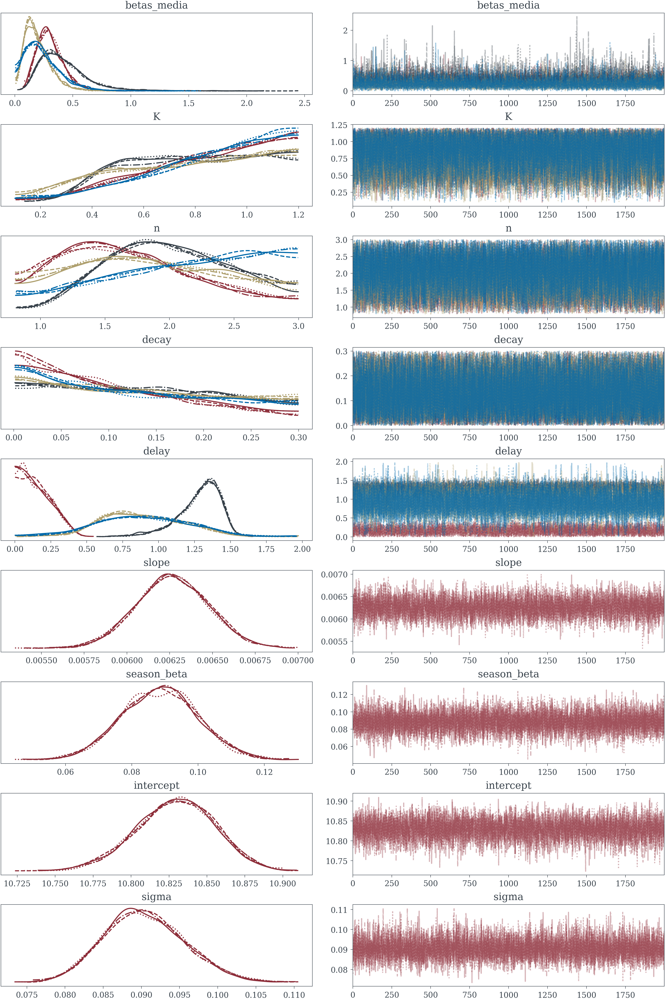

In [41]:
pm.plot_trace(trace, var_names=["betas_media", "K", "n", "decay", "delay", "slope", "season_beta", "intercept", "sigma"])

In [56]:
media_effect = trace.posterior['media_effect'].mean(axis=(0, 1)).values; 
media_effect_lower = np.quantile(trace.posterior['media_effect'].values, .05, axis=(0, 1))
media_effect_upper = np.quantile(trace.posterior['media_effect'].values, .95, axis=(0, 1))
media_effects_t = betas_media_t * media_vars_transformed

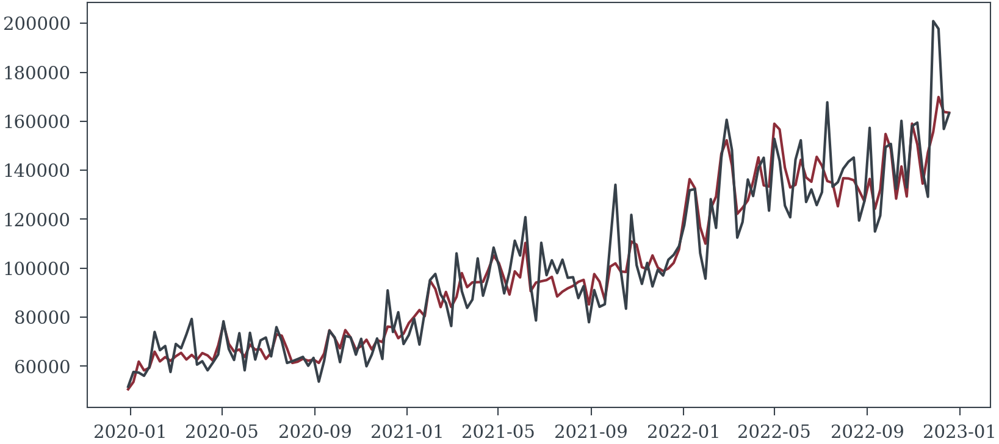

In [44]:
plt.plot(dates, np.exp(ppc.posterior_predictive["sales"].mean(axis=(0, 1))))
plt.plot(dates, sales)

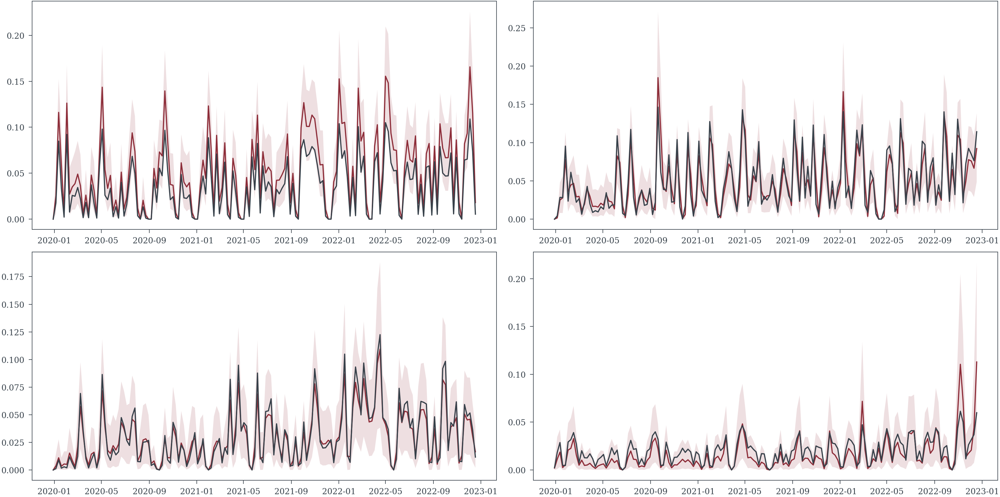

In [57]:
fig, ax = plt.subplots(2, 2, figsize=(12, 6))
for i in range(4):
    ax[i//2, i%2].plot(dates, media_effect[:, i])
    ax[i//2, i%2].fill_between(dates, media_effect_lower[:, i], media_effect_upper[:, i], alpha=0.15)
    ax[i//2, i%2].plot(dates, media_effects_t[:, i])
    